# Case Study: Data Science in NYC Taxi and Uber Data

the NYC taxi and Uber dataset from [here](https://github.com/toddwschneider/nyc-taxi-data).

The case study focuses on finding the 10 most popular uber pickup locations in New York City. I have used K means clustering to find out the most popular pickup locations. Then using Folium I have plotted the cluster centers and data points on the NYC map. Then using geopy package I have found the exact place name for the latitude and longitude of the k means centroids. Finally I have found the busiest day and time for uber pickups in NYC.

# Data Collection/Processing: 

In [ ]:

# Python Libraries Imported
import numpy as np
import warnings
import itertools
import datetime as dt
import matplotlib.pyplot as plt
import pandas as pd
import folium
from sklearn.cluster import KMeans


%matplotlib inline


uber2014 = pd.concat([pd.read_csv('C:/Users/joshi/Desktop/dataset/uber-raw-data-apr14.csv'),
                          pd.read_csv('C:/Users/joshi/Desktop/dataset/uber-raw-data-may14.csv'),
                          pd.read_csv('C:/Users/joshi/Desktop/dataset/uber-raw-data-jun14.csv'),
                          pd.read_csv('C:/Users/joshi/Desktop/dataset/uber-raw-data-jul14.csv'),
                          pd.read_csv('C:/Users/joshi/Desktop/dataset/uber-raw-data-aug14.csv'),
                          pd.read_csv('C:/Users/joshi/Desktop/dataset/uber-raw-data-sep14.csv')])
uber2014.head(10)


,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512
5,4/1/2014 0:33:00,40.7383,-74.0403,B02512
6,4/1/2014 0:39:00,40.7223,-73.9887,B02512
7,4/1/2014 0:45:00,40.7620,-73.9790,B02512
8,4/1/2014 0:55:00,40.7524,-73.9960,B02512
9,4/1/2014 1:01:00,40.7575,-73.9846,B02512


# Data Exploration: Exploring the Uber/Taxi Dataset

**plotting the spatial distribution of the pickup locations of 5000 Uber trips** 
* collecting a set of 5000 Uber trips
* ploting the distribution of the pickup locations using a scatter plot figure.

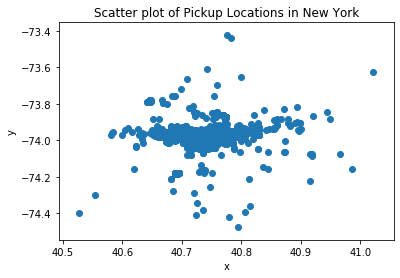

In [ ]:
#Plotting first 5000 data points in a scatter plot
uber2014_5000=uber2014[0:5000]
uberFirst5000Data = folium.Map(
    location=[40.7128, -74.0060] # Location: NY
)

location = zip(uber2014_5000['Lat'], uber2014_5000['Lon'])
for l in location:
    folium.Circle(location=l, radius=10).add_to(uberFirst5000Data)
uberFirst5000Data.save('foliumUber.html')
x = uber2014_5000['Lat']
y = uber2014_5000['Lon']
plt.scatter(x, y)
plt.title('Scatter plot of Pickup Locations in New York')
plt.xlabel('x')
plt.ylabel('y')
plt.show()

# The Data Science Solution: Finding the busiest Day and time for Uber Pickups

K means Clustering: In K means clustering using scktlearn library,I have chosen K = 10 to find the 10 most popular uber pickup locations in NYC.
#### Folium: Using Folium package I have plotted the cluster centers and data points on the NEW YORK City map.
#### Geopy: Using Geopy package I have found the place name for the latitude and longitude of the cluster centroids.
#### Finding the busiest Day and Time

In [ ]:
#Finding the latitude and longitude of the K centers for nyc boroughs
lats = uber2014['Lat']
lons = uber2014['Lon']
date = uber2014['Date/Time']
coordinates = np.vstack((date,lats,lons)).T
sample = coordinates[np.random.choice(len(coordinates),20000)]
date = sample[:,0]
sample_lats = sample[:,1]
sample_lons = sample[:,2]


X = list(zip(sample_lats, sample_lons))

kmeans = KMeans(n_clusters=10, random_state=0).fit(X)
n_cluster = kmeans.cluster_centers_
n_cluster


array([[ 40.75541291, -73.98279091],
       [ 40.75384085, -73.59082958],
       [ 40.76418921, -73.86686222],
       [ 40.67016059, -73.97978377],
       [ 40.65224091, -73.78385822],
       [ 40.69019545, -74.20373682],
       [ 40.72674553, -74.00026568],
       [ 40.78158678, -73.95836737],
       [ 40.71073864, -73.94563842],
       [ 40.8928746 , -73.88761587]])

In [ ]:
#Using Geopy library to find the address of the longitude and latitude
n = len(n_cluster)
from geopy.geocoders import Nominatim
geolocator = Nominatim(user_agent="uber_app")
for i  in range(n):
    street = geolocator.reverse(str(n_cluster[i][0])+","+str(n_cluster[i][1]))
    print("->",street.address)

-> Hippodrome Building, 1120, 6th Avenue, Theater District, Manhattan Community Board 5, Manhattan, New York County, New York, 10036, United States
-> 160, Butler Street, Westbury, North Hempstead, Nassau County, New York, 11590, United States
-> 103-05, 27th Avenue, East Elmhurst, Queens, Queens County, New York, 11369, United States
-> 426, 4th Street, Park Slope, Brooklyn, Kings County, New York, 11215, United States
-> 5, Terminal 7 departures, Queens, Queens County, New York, 11430, United States
-> 99, Van Vechten Street, Newark, Essex County, New Jersey, 07114, United States
-> 480, West Broadway, SoHo, Manhattan Community Board 2, Manhattan, New York County, New York, 10012, United States
-> 21, East 87th Street, Yorkville, Manhattan Community Board 8, Manhattan, New York County, New York, 10128, United States
-> 125, Maujer Street, Williamsburg, Brooklyn, Kings County, New York, 11206, United States
-> Van Cortlandt Golf Course, Mosholu Parkway, The Bronx, Bronx County, New Yo

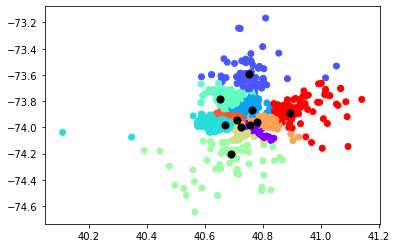

In [ ]:
#plotting data points and cluster centers in a scatter plot
plt.scatter(sample_lats, sample_lons, c = kmeans.labels_ , cmap = 'rainbow')
plt.scatter(n_cluster[:, 0], n_cluster[:, 1], s=50, c='black')
plt.show()

In [ ]:
#Including Cluster labels for the locations in Uber pickups
Final_uber = pd.DataFrame(sample)
Final_uber['Cluster_label'] = kmeans.labels_

Final_uber.columns=['Time','Lat','Lon','Cluster_label']
Final_uber.head(10)

,Time,Lat,Lon,Cluster_label
0,5/18/2014 3:18:00,40.7325,-73.9829,6
1,5/16/2014 9:07:00,40.6949,-74.178,5
2,5/5/2014 20:52:00,40.7278,-73.9947,6
3,6/20/2014 17:15:00,40.7441,-73.9841,0
4,5/14/2014 7:36:00,40.7326,-73.9972,6
5,8/21/2014 12:22:00,40.7449,-73.9842,0
6,4/29/2014 20:46:00,40.7294,-73.987,6
7,7/27/2014 14:44:00,40.6774,-74.0144,3
8,4/12/2014 12:09:00,40.7478,-74.0092,6
9,6/21/2014 18:47:00,40.7665,-73.978,0


In [ ]:
import folium
cluster_map = folium.Map(
    location=[40.7128, -74.0060], # new york coordinates
    zoom_start=11
)
colors = {'0' : 'red', '1' : 'blue','2' : 'green', '3' : 'teal', '4' : 'orange', '5' : 'brown', '6' : 'magenta','7' : 'purple','8' : 'black', '9' : 'pink'}
locationlst = zip(Final_uber['Lat'], Final_uber['Lon'],Final_uber['Cluster_label'])
for l in locationlst:
    folium.Circle(radius=20,location=(l[0],l[1]), color=colors[str(l[2])]).add_to(cluster_map)
    
locationlst1 = zip(n_cluster[:, 0], n_cluster[:, 1])
for l in locationlst1:
    folium.Marker(location=(l[0],l[1])).add_to(cluster_map)
    
cluster_map #.save('Clusters of NYC Uber pickups.html')
#may not see the map in chrome, please open with firefox

In [ ]:
#Finding the cluster lables for the busiest locations for Uber pickups
Grouped = Final_uber.groupby('Cluster_label').count().reset_index()
Grouped
Most_popular = Grouped.sort_values('Time', ascending = False)
Most_popular

,Cluster_label,Time,Lat,Lon
6,6,6631,6631,6631
0,0,6460,6460,6460
7,7,2612,2612,2612
8,8,1324,1324,1324
3,3,1254,1254,1254
2,2,667,667,667
4,4,572,572,572
5,5,220,220,220
9,9,189,189,189
1,1,71,71,71


[Text(0, 0.5, 'No. of Pickups'),
 Text(0.5, 0, 'Cluster No.'),
 Text(0.5, 1.0, 'Highest number of Pickup Zones')]

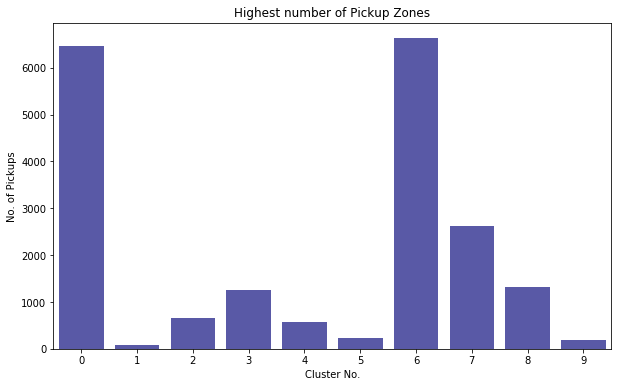

In [ ]:
import seaborn as sns
plt.figure(figsize=(10,6))
ax = sns.countplot(Final_uber['Cluster_label'],color = 'blue', saturation = 0.3)
ax.set(xlabel = 'Cluster No.', ylabel = 'No. of Pickups',title='Highest number of Pickup Zones')


In [ ]:
#creating a subset for the locations in the most popular cluster
data_subset=Final_uber.loc[Final_uber['Cluster_label']==Most_popular.iloc[0][0]]
data_subset.head(10) 

,Time,Lat,Lon,Cluster_label
0,5/18/2014 3:18:00,40.7325,-73.9829,6
2,5/5/2014 20:52:00,40.7278,-73.9947,6
4,5/14/2014 7:36:00,40.7326,-73.9972,6
6,4/29/2014 20:46:00,40.7294,-73.987,6
8,4/12/2014 12:09:00,40.7478,-74.0092,6
10,6/7/2014 8:01:00,40.7373,-73.9946,6
14,7/5/2014 18:33:00,40.7199,-74.0041,6
15,6/12/2014 7:20:00,40.7339,-73.9805,6
17,7/12/2014 22:50:00,40.7406,-74.0067,6
18,6/28/2014 15:20:00,40.716,-74.007,6


In [ ]:
#Performing K means again for the specific cluster
xTrain = list(zip(data_subset['Lat'], data_subset['Lon']))
kmeans2 = KMeans(n_clusters=10, random_state=0).fit(xTrain)
kmeans2.labels_
n_cluster2 = kmeans2.cluster_centers_
n_cluster2

array([[ 40.72263444, -73.99434497],
       [ 40.7312509 , -74.00360777],
       [ 40.72301233, -74.04734521],
       [ 40.70315959, -73.98967329],
       [ 40.70971889, -74.01072527],
       [ 40.73580467, -73.99215949],
       [ 40.7416501 , -74.00449848],
       [ 40.72610242, -73.98351168],
       [ 40.74749639, -74.03438675],
       [ 40.72079812, -74.00544729]])

In [ ]:
n_subset = len(n_cluster2)
for i  in range(n_subset):
    sub_street = geolocator.reverse(str(n_cluster2[i][0])+","+str(n_cluster2[i][1]))
    print("->",sub_street.address)

-> Vince, 16, Prince Street, SoHo, Manhattan Community Board 2, Manhattan, New York County, New York, 10012, United States
-> The Doughnut Project, 10, Morton Street, West Village, Manhattan Community Board 2, Manhattan, New York County, New York, 10014, United States
-> 42, Coles Street, Jersey City, Hudson County, New Jersey, 07302, United States
-> DUMBO Historic District Proposal, Brooklyn-Queens Expressway, DUMBO, Brooklyn, Kings County, New York, 11201-1832, United States
-> One Liberty Plaza, Liberty Street, Financial District, Manhattan Community Board 1, Manhattan, New York County, New York, 10005, United States
-> The Victoria, 7, East 14th Street, Union Square, Manhattan Community Board 2, Manhattan, New York County, New York, 10003, United States
-> 111 Eighth Avenue, 8th Avenue, Chelsea, Manhattan Community Board 4, Manhattan, New York County, New York, 10017, United States
-> 115, Avenue A, East Village, Manhattan Community Board 3, Manhattan, New York County, New York, 1

In [ ]:
data_subset['Cluster_sub_label'] = kmeans2.labels_
data_subset.head(10)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  """Entry point for launching an IPython kernel.


,Time,Lat,Lon,Cluster_label,Cluster_sub_label
0,5/18/2014 3:18:00,40.7325,-73.9829,6,7
2,5/5/2014 20:52:00,40.7278,-73.9947,6,0
4,5/14/2014 7:36:00,40.7326,-73.9972,6,5
6,4/29/2014 20:46:00,40.7294,-73.987,6,7
8,4/12/2014 12:09:00,40.7478,-74.0092,6,6
10,6/7/2014 8:01:00,40.7373,-73.9946,6,5
14,7/5/2014 18:33:00,40.7199,-74.0041,6,9
15,6/12/2014 7:20:00,40.7339,-73.9805,6,7
17,7/12/2014 22:50:00,40.7406,-74.0067,6,6
18,6/28/2014 15:20:00,40.716,-74.007,6,9


In [ ]:
cluster_map2 = folium.Map(
    location=[40.7128, -74.0060], # new york coordinates
    zoom_start=13
)
colors = {'0' : 'red', '1' : 'blue','2' : 'green', '3' : 'teal', '4' : 'orange', '5' : 'brown', '6' : 'magenta','7' : 'purple','8' : 'black', '9' : 'pink'}
locationlst = zip(data_subset['Lat'], data_subset['Lon'],data_subset['Cluster_sub_label'])
for l in locationlst:
    folium.Circle(radius=10,location=(l[0],l[1]), color=colors[str(l[2])]).add_to(cluster_map2)
cluster_map2
#may not see the map in chrome, please open with firefox

In [ ]:
#finding the most popular date and time for the busiest locations
from datetime import datetime

data_subset['timedate']=pd.to_datetime(data_subset['Time'], format='%m/%d/%Y %H:%M:%S')
data_subset=pd.DataFrame(data_subset)
data_subset['hour']=data_subset['timedate'].dt.hour
data_subset['weekday']=data_subset['timedate'].dt.dayofweek

morning = range(6,12)
afternoon = range(12,17)
evening = range(17,20)
night = range(20,24)
latenight=range(0,6)


timeoftheday = np.empty(len(data_subset),dtype='S10')
timeoftheday[np.where(np.in1d(data_subset['hour'],latenight))] = 'Midnight'
timeoftheday[np.where(np.in1d(data_subset['hour'],morning))] = 'Morning'
timeoftheday[np.where(np.in1d(data_subset['hour'],afternoon))] = 'Afternoon'
timeoftheday[np.where(np.in1d(data_subset['hour'],evening))] = 'Evening'
timeoftheday[np.where(np.in1d(data_subset['hour'],night))] = 'Night'
data_subset['timeoftheday'] = timeoftheday
data_subset.head(10)

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.


,Time,Lat,Lon,Cluster_label,Cluster_sub_label,timedate,hour,weekday,timeoftheday
0,5/18/2014 3:18:00,40.7325,-73.9829,6,7,2014-05-18 03:18:00,3,6,b'Midnight'
2,5/5/2014 20:52:00,40.7278,-73.9947,6,0,2014-05-05 20:52:00,20,0,b'Night'
4,5/14/2014 7:36:00,40.7326,-73.9972,6,5,2014-05-14 07:36:00,7,2,b'Morning'
6,4/29/2014 20:46:00,40.7294,-73.987,6,7,2014-04-29 20:46:00,20,1,b'Night'
8,4/12/2014 12:09:00,40.7478,-74.0092,6,6,2014-04-12 12:09:00,12,5,b'Afternoon'
10,6/7/2014 8:01:00,40.7373,-73.9946,6,5,2014-06-07 08:01:00,8,5,b'Morning'
14,7/5/2014 18:33:00,40.7199,-74.0041,6,9,2014-07-05 18:33:00,18,5,b'Evening'
15,6/12/2014 7:20:00,40.7339,-73.9805,6,7,2014-06-12 07:20:00,7,3,b'Morning'
17,7/12/2014 22:50:00,40.7406,-74.0067,6,6,2014-07-12 22:50:00,22,5,b'Night'
18,6/28/2014 15:20:00,40.716,-74.007,6,9,2014-06-28 15:20:00,15,5,b'Afternoon'


[Text(0, 0.5, 'Count'), Text(0.5, 0, 'Day of week')]

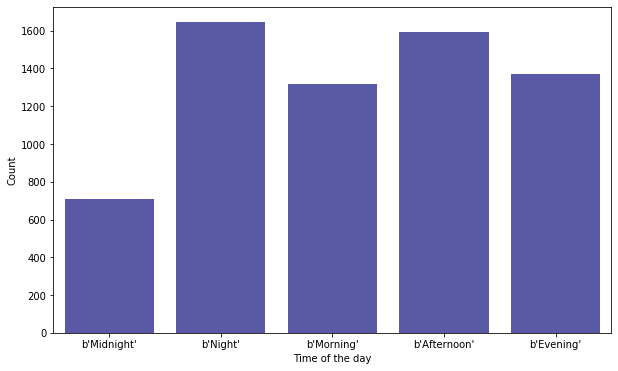

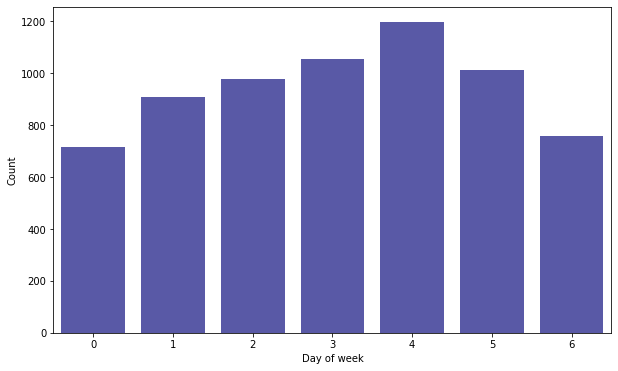

In [ ]:
plt.figure(figsize=(10,6))
ax = sns.countplot(data_subset['timeoftheday'],color = 'blue', saturation = 0.3)
ax.set(xlabel = 'Time of the day', ylabel = 'Count')

plt.figure(figsize=(10,6))
ax = sns.countplot(data_subset['weekday'],color = 'blue', saturation = 0.3)
ax.set(xlabel = 'Day of week', ylabel = 'Count')

# Final result

In [ ]:
#final result showing the most popular boroughs in nyc for Uber pickups

import folium
cluster_map = folium.Map(
    location=[40.7128, -74.0060], # new york coordinates
    zoom_start=11
)
colors = {'0' : 'red', '1' : 'blue','2' : 'green', '3' : 'teal', '4' : 'orange', '5' : 'brown', '6' : 'magenta','7' : 'purple','8' : 'black', '9' : 'pink'}
locationlst = zip(Final_uber['Lat'], Final_uber['Lon'],Final_uber['Cluster_label'])
for l in locationlst:
    folium.Circle(radius=20,location=(l[0],l[1]), color=colors[str(l[2])]).add_to(cluster_map)
    
locationlst1 = zip(n_cluster[:, 0], n_cluster[:, 1])
for l in locationlst1:
    folium.Marker(location=(l[0],l[1])).add_to(cluster_map)
    
cluster_map
#may not see the map in chrome, please open with firefox